In [1]:
import pandas as pd
import numpy as np
pd.set_option('display.max_columns', None)
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.linear_model import LinearRegression
from xgboost.sklearn import XGBRegressor
from sklearn.linear_model import SGDRegressor
from sklearn.kernel_ridge import KernelRidge
from sklearn.linear_model import BayesianRidge
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.linear_model import Lasso
from sklearn.kernel_ridge import KernelRidge
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import Ridge
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_validate
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error

# Data Gathering

In [2]:
Arrest=pd.read_csv("D:\\nile\\Final project\\Chicago\\Arrests.csv")
crimes=pd.read_csv('D:\\nile\\Final project\\Chicago\\Crimes_-_2001_to_Present.csv')
Affordable_Rental_Housing=pd.read_csv('D:\\nile\\Final project\\Chicago\\Affordable_Rental_Housing_Developments.csv')
Census=pd.read_csv('D:\\nile\\Final project\\Chicago\\Census_Data_-_Selected_socioeconomic_indicators_in_Chicago__2008___2012.csv')
Traffic_crashes=pd.read_csv('D:\\nile\\Final project\\Chicago\\Traffic_Crashes_-_Crashes.csv')
Transportation=pd.read_csv('D:\\nile\\Final project\\Chicago\\Average_Daily_Traffic_Counts.csv')
Schools=pd.read_csv('D:\\nile\\Final project\\Chicago\\Chicago_Public_Schools_-_School_Profile_Information_SY1819.csv')
public_health=pd.read_csv('D:\\nile\\Final project\\Chicago\\Public_Health_Statistics-_Selected_public_health_indicators_by_Chicago_community_area.csv')
violence_reduction=pd.read_csv('D:\\nile\\Final project\\Chicago\\Violence_Reduction_-_Victims_of_Homicides_and_Non-Fatal_Shootings.csv')
birth_rates=pd.read_csv('D:\\nile\\Final project\\Chicago\\Public_Health_Statistics_-_Births_and_birth_rates_in_Chicago__by_year__1999___2009.csv')

In [3]:
Affordable_Rental_Housing.head(5)
Affordable_Rental_Housing['Community Area Number'].nunique()

63

### Join Crimes with Arrest Data

In [4]:
crimes.head(5)

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
0,10060004,HY248774,5/5/2015 23:45,010XX W 79TH ST,460,BATTERY,SIMPLE,SIDEWALK,False,False,612,6.0,17.0,71.0,08B,1170778.0,1852475.0,2015,5/12/2015 12:42,41.750667,-87.649760,"(41.75066697, -87.649760051)"
1,10059982,HY248801,5/5/2015 23:45,105XX S WABASH AVE,420,BATTERY,AGGRAVATED:KNIFE/CUTTING INSTR,RESIDENCE,False,False,512,5.0,9.0,49.0,04B,1178485.0,1834909.0,2015,5/12/2015 12:42,41.702292,-87.622050,"(41.702292131, -87.622049984)"
2,10059953,HY248791,5/5/2015 23:45,005XX N ASHLAND AVE,2027,NARCOTICS,POSS: CRACK,SIDEWALK,True,False,1215,13.0,26.0,24.0,18,1165594.0,1903713.0,2015,5/12/2015 12:42,41.891381,-87.667301,"(41.891381064, -87.66730127)"
3,10060015,HY248790,5/5/2015 23:35,005XX N MARSHFIELD AVE,275,CRIM SEXUAL ASSAULT,ATTEMPT AGG: OTHER,ALLEY,False,False,1215,13.0,26.0,24.0,2,1165337.0,1903842.0,2015,5/12/2015 12:42,41.891741,-87.668241,"(41.89174052, -87.668241434)"
4,10059944,HY248782,5/5/2015 23:34,0000X E 72ND ST,2024,NARCOTICS,POSS: HEROIN(WHITE),STREET,True,False,323,3.0,6.0,69.0,18,1178073.0,1857256.0,2015,5/12/2015 12:42,41.763624,-87.622883,"(41.763624424, -87.622883163)"


In [5]:
crimes.isna().sum()

ID                         0
Case Number                0
Date                       0
Block                      0
IUCR                       0
Primary Type               0
Description                0
Location Description     613
Arrest                     0
Domestic                   0
Beat                       0
District                6469
Ward                      14
Community Area           139
FBI Code                   0
X Coordinate            6455
Y Coordinate            6455
Year                       0
Updated On               115
Latitude                6455
Longitude               6455
Location                6455
dtype: int64

In [6]:
crimes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 22 columns):
 #   Column                Non-Null Count    Dtype  
---  ------                --------------    -----  
 0   ID                    1048575 non-null  int64  
 1   Case Number           1048575 non-null  object 
 2   Date                  1048575 non-null  object 
 3   Block                 1048575 non-null  object 
 4   IUCR                  1048575 non-null  object 
 5   Primary Type          1048575 non-null  object 
 6   Description           1048575 non-null  object 
 7   Location Description  1047962 non-null  object 
 8   Arrest                1048575 non-null  bool   
 9   Domestic              1048575 non-null  bool   
 10  Beat                  1048575 non-null  int64  
 11  District              1042106 non-null  float64
 12  Ward                  1048561 non-null  float64
 13  Community Area        1048436 non-null  float64
 14  FBI Code              1048575 non-

In [7]:
Arrest.head(5)

,CB_NO,CASE NUMBER,ARREST DATE,RACE,CHARGE 1 STATUTE,CHARGE 1 DESCRIPTION,CHARGE 1 TYPE,CHARGE 1 CLASS,CHARGE 2 STATUTE,CHARGE 2 DESCRIPTION,CHARGE 2 TYPE,CHARGE 2 CLASS,CHARGE 3 STATUTE,CHARGE 3 DESCRIPTION,CHARGE 3 TYPE,CHARGE 3 CLASS,CHARGE 4 STATUTE,CHARGE 4 DESCRIPTION,CHARGE 4 TYPE,CHARGE 4 CLASS,CHARGES STATUTE,CHARGES DESCRIPTION,CHARGES TYPE,CHARGES CLASS
0,18922700,NaN,06/26/2014 10:51:00 PM,BLACK,725 ILCS 5.0/110-3,ISSUANCE OF WARRANT,NaN,Z,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,725 ILCS 5.0/110-3 | | |,ISSUANCE OF WARRANT | | |,| | |,Z | | |
1,18922086,NaN,06/26/2014 12:07:00 AM,BLACK,625 ILCS 5.0/6-303-A,DRIVING ON SUSPENDED LICENSE,M,A,9-76-160(A),DISPLAY ST REG-FRONT/REAR,NaN,L,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,625 ILCS 5.0/6-303-A | 9-76-160(A) | |,DRIVING ON SUSPENDED LICENSE | DISPLAY ST REG-...,M | | |,A | L | |
2,18908465,HX290868,06/05/2014 11:58:00 AM,BLACK,720 ILCS 570.0/402-C,PCS - POSSESSION - POSS AMT CON SUB EXCEPT (A)(D),F,4,720 ILCS 600.0/3.5-A,PCS - DRUG PARAPHERNALIA - POSSESS,M,A,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,720 ILCS 570.0/402-C | 720 ILCS 600.0/3.5-A | |,PCS - POSSESSION - POSS AMT CON SUB EXCEPT (A)...,F | M | |,4 | A | |
3,18914257,HX302763,06/14/2014 04:50:00 AM,BLACK,720 ILCS 5.0/12-3-A-1,BATTERY - CAUSE BODILY HARM,M,A,520 ILCS 5.0/1.22,RESIST/OBSTRUCT OFFICER,M,A,720 ILCS 5.0/12-3-A-1,BATTERY - CAUSE BODILY HARM,M,A,NaN,NaN,NaN,NaN,720 ILCS 5.0/12-3-A-1 | 520 ILCS 5.0/1.22 | 72...,BATTERY - CAUSE BODILY HARM | RESIST/OBSTRUCT ...,M | M | M |,A | A | A |
4,18911035,NaN,06/09/2014 08:45:00 AM,BLACK,8-4-030,DRINKING ALCOHOL ON THE PUBLIC WAY,NaN,L,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8-4-030 | | |,DRINKING ALCOHOL ON THE PUBLIC WAY | | |,| | |,L | | |


In [8]:
Arrest.isna().sum()

CB_NO                        0
CASE NUMBER             212890
ARREST DATE                  0
RACE                         0
CHARGE 1 STATUTE             0
CHARGE 1 DESCRIPTION         0
CHARGE 1 TYPE           115269
CHARGE 1 CLASS            4726
CHARGE 2 STATUTE        310159
CHARGE 2 DESCRIPTION    310159
CHARGE 2 TYPE           406158
CHARGE 2 CLASS          312370
CHARGE 3 STATUTE        410402
CHARGE 3 DESCRIPTION    410402
CHARGE 3 TYPE           489759
CHARGE 3 CLASS          411041
CHARGE 4 STATUTE        464290
CHARGE 4 DESCRIPTION    464290
CHARGE 4 TYPE           514269
CHARGE 4 CLASS          464493
CHARGES STATUTE              0
CHARGES DESCRIPTION          0
CHARGES TYPE                 0
CHARGES CLASS                0
dtype: int64

In [9]:
crimes.drop(['IUCR','ID','Block','FBI Code'],axis=1,inplace=True)
crimes.head(5)

,Case Number,Date,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
0,HY248774,5/5/2015 23:45,BATTERY,SIMPLE,SIDEWALK,False,False,612,6.0,17.0,71.0,1170778.0,1852475.0,2015,5/12/2015 12:42,41.750667,-87.649760,"(41.75066697, -87.649760051)"
1,HY248801,5/5/2015 23:45,BATTERY,AGGRAVATED:KNIFE/CUTTING INSTR,RESIDENCE,False,False,512,5.0,9.0,49.0,1178485.0,1834909.0,2015,5/12/2015 12:42,41.702292,-87.622050,"(41.702292131, -87.622049984)"
2,HY248791,5/5/2015 23:45,NARCOTICS,POSS: CRACK,SIDEWALK,True,False,1215,13.0,26.0,24.0,1165594.0,1903713.0,2015,5/12/2015 12:42,41.891381,-87.667301,"(41.891381064, -87.66730127)"
3,HY248790,5/5/2015 23:35,CRIM SEXUAL ASSAULT,ATTEMPT AGG: OTHER,ALLEY,False,False,1215,13.0,26.0,24.0,1165337.0,1903842.0,2015,5/12/2015 12:42,41.891741,-87.668241,"(41.89174052, -87.668241434)"
4,HY248782,5/5/2015 23:34,NARCOTICS,POSS: HEROIN(WHITE),STREET,True,False,323,3.0,6.0,69.0,1178073.0,1857256.0,2015,5/12/2015 12:42,41.763624,-87.622883,"(41.763624424, -87.622883163)"


In [10]:
Arrest.drop(['CB_NO','CHARGE 1 STATUTE','CHARGE 1 DESCRIPTION','CHARGE 1 TYPE','CHARGE 1 CLASS','CHARGE 2 STATUTE',
             'CHARGE 2 DESCRIPTION','CHARGE 2 TYPE','CHARGE 2 CLASS','CHARGE 3 STATUTE','CHARGE 3 DESCRIPTION',
            'CHARGE 3 TYPE','CHARGE 3 CLASS','CHARGE 4 STATUTE','CHARGE 4 DESCRIPTION','CHARGE 4 TYPE','CHARGE 4 CLASS',
            'CHARGES STATUTE','CHARGES DESCRIPTION','CHARGES TYPE','CHARGES CLASS'],axis=1,inplace=True)
Arrest.head(5)

,CASE NUMBER,ARREST DATE,RACE
0,NaN,06/26/2014 10:51:00 PM,BLACK
1,NaN,06/26/2014 12:07:00 AM,BLACK
2,HX290868,06/05/2014 11:58:00 AM,BLACK
3,HX302763,06/14/2014 04:50:00 AM,BLACK
4,NaN,06/09/2014 08:45:00 AM,BLACK


In [11]:
Arrest.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 530990 entries, 0 to 530989
Data columns (total 3 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   CASE NUMBER  318100 non-null  object
 1   ARREST DATE  530990 non-null  object
 2   RACE         530990 non-null  object
dtypes: object(3)
memory usage: 12.2+ MB


In [12]:

crimes_arrest=pd.merge(crimes,Arrest,how='inner',left_on=['Case Number'],right_on=['CASE NUMBER'])
crimes_arrest.drop('CASE NUMBER',axis=1,inplace=True)
crimes_arrest.head(6)
crimes_arrest.head(6)

,Case Number,Date,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location,ARREST DATE,RACE
0,HY248696,5/5/2015 20:32,CRIMINAL TRESPASS,TO LAND,APARTMENT,True,False,2412,24.0,50.0,2.0,1160757.0,1942935.0,2015,5/12/2015 12:42,41.999110,-87.683974,"(41.999110172, -87.683974017)",05/05/2015 08:42:00 PM,BLACK
1,HY248402,5/5/2015 17:15,ASSAULT,AGGRAVATED: HANDGUN,STREET,True,False,411,4.0,8.0,45.0,1185124.0,1850889.0,2015,5/12/2015 12:42,41.745990,-87.597240,"(41.745990032, -87.597239699)",05/06/2015 02:00:00 AM,BLACK
2,HY248396,5/5/2015 17:05,THEFT,RETAIL THEFT,DEPARTMENT STORE,True,False,1733,17.0,33.0,21.0,1155968.0,1923741.0,2015,5/12/2015 12:42,41.946539,-87.702112,"(41.946539101, -87.702111692)",05/05/2015 05:45:00 PM,WHITE HISPANIC
3,HY248370,5/5/2015 15:31,DECEPTIVE PRACTICE,THEFT OF LABOR/SERVICES,SIDEWALK,True,False,1834,18.0,42.0,8.0,1178338.0,1905061.0,2015,5/12/2015 12:42,41.894799,-87.620458,"(41.894799054, -87.620457932)",05/05/2015 05:22:00 PM,WHITE HISPANIC
4,HY248288,5/5/2015 15:21,OTHER OFFENSE,PAROLE VIOLATION,STREET,True,False,322,3.0,20.0,69.0,1177946.0,1859659.0,2015,5/12/2015 12:42,41.770221,-87.623276,"(41.770221395, -87.623275934)",05/05/2015 03:43:00 PM,BLACK
5,HY249179,5/5/2015 15:00,BATTERY,SIMPLE,CTA BUS,True,False,512,5.0,9.0,50.0,1183355.0,1836807.0,2015,5/12/2015 12:42,41.707389,-87.604159,"(41.707388726, -87.604158702)",05/06/2015 11:30:00 AM,BLACK


In [13]:

crimes_arrest['Day parts'] = pd.cut(pd.to_datetime(crimes_arrest.Date).dt.hour,
       bins=[0, 6, 12, 18, 24],
       labels=['night', 'morning', 'afternoon', 'evening'],
       right=False,
       include_lowest=True)

crimes_arrest.head(2)


,Case Number,Date,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location,ARREST DATE,RACE,Day parts
0,HY248696,5/5/2015 20:32,CRIMINAL TRESPASS,TO LAND,APARTMENT,True,False,2412,24.0,50.0,2.0,1160757.0,1942935.0,2015,5/12/2015 12:42,41.99911,-87.683974,"(41.999110172, -87.683974017)",05/05/2015 08:42:00 PM,BLACK,evening
1,HY248402,5/5/2015 17:15,ASSAULT,AGGRAVATED: HANDGUN,STREET,True,False,411,4.0,8.0,45.0,1185124.0,1850889.0,2015,5/12/2015 12:42,41.74599,-87.597240,"(41.745990032, -87.597239699)",05/06/2015 02:00:00 AM,BLACK,afternoon


In [14]:

type_count=crimes_arrest.groupby(['Community Area','Day parts','Primary Type']).agg({'Primary Type':'count'}) 
type_count.rename({'Primary Type':"Primary type counts",'Arrest':'Arrest counts','RACE':'RACE Counts'},axis=1,inplace=True)
type_count = type_count.reset_index()
type_count


,Community Area,Day parts,Primary Type,Primary type counts
0,1.0,night,ARSON,0
1,1.0,night,ASSAULT,21
2,1.0,night,BATTERY,50
3,1.0,night,BURGLARY,7
4,1.0,night,CONCEALED CARRY LICENSE VIOLATION,0
...,...,...,...,...
8927,77.0,evening,ROBBERY,2
8928,77.0,evening,SEX OFFENSE,4
8929,77.0,evening,STALKING,0
8930,77.0,evening,THEFT,57


In [15]:
type_count['Community Area'].nunique()

77

### Join with census data

In [16]:
Census.head(3)

,Community Area Number,COMMUNITY AREA NAME,PERCENT OF HOUSING CROWDED,PERCENT HOUSEHOLDS BELOW POVERTY,PERCENT AGED 16+ UNEMPLOYED,PERCENT AGED 25+ WITHOUT HIGH SCHOOL DIPLOMA,PERCENT AGED UNDER 18 OR OVER 64,PER CAPITA INCOME,HARDSHIP INDEX
0,1.0,Rogers Park,7.7,23.6,8.7,18.2,27.5,23939,39.0
1,2.0,West Ridge,7.8,17.2,8.8,20.8,38.5,23040,46.0
2,3.0,Uptown,3.8,24.0,8.9,11.8,22.2,35787,20.0


In [17]:
Census.drop(['PERCENT OF HOUSING CROWDED','PERCENT HOUSEHOLDS BELOW POVERTY',
                   'PER CAPITA INCOME '],axis=1,inplace=True)

In [18]:
Census['Community Area Number'].nunique()

77

In [19]:
crimes_Census=pd.merge(type_count,Census,how='inner',left_on=['Community Area'],right_on=['Community Area Number'])
crimes_Census.drop('Community Area Number',axis=1,inplace=True)
crimes_Census.shape
crimes_Census.head(3)

,Community Area,Day parts,Primary Type,Primary type counts,COMMUNITY AREA NAME,PERCENT AGED 16+ UNEMPLOYED,PERCENT AGED 25+ WITHOUT HIGH SCHOOL DIPLOMA,PERCENT AGED UNDER 18 OR OVER 64,HARDSHIP INDEX
0,1.0,night,ARSON,0,Rogers Park,8.7,18.2,27.5,39.0
1,1.0,night,ASSAULT,21,Rogers Park,8.7,18.2,27.5,39.0
2,1.0,night,BATTERY,50,Rogers Park,8.7,18.2,27.5,39.0


### Join with Public health

In [20]:
public_health.head(5)

,Community Area,Community Area Name,Birth Rate,General Fertility Rate,Low Birth Weight,Prenatal Care Beginning in First Trimester,Preterm Births,Teen Birth Rate,Assault (Homicide),Breast cancer in females,Cancer (All Sites),Colorectal Cancer,Diabetes-related,Firearm-related,Infant Mortality Rate,Lung Cancer,Prostate Cancer in Males,Stroke (Cerebrovascular Disease),Childhood Blood Lead Level Screening,Childhood Lead Poisoning,Gonorrhea in Females,Gonorrhea in Males,Tuberculosis,Below Poverty Level,Crowded Housing,Dependency,No High School Diploma,Per Capita Income,Unemployment
0,1,Rogers Park,16.4,62.0,11.0,73.0,11.2,40.8,7.7,23.3,176.9,25.3,77.1,5.2,6.4,36.7,21.7,33.7,364.7,0.5,322.5,423.3,11.4,22.7,7.9,28.8,18.1,23714,7.5
1,2,West Ridge,17.3,83.3,8.1,71.1,8.3,29.9,5.8,20.2,155.9,17.3,60.5,3.7,5.1,36.0,14.2,34.7,331.4,1.0,141.0,205.7,8.9,15.1,7.0,38.3,19.6,21375,7.9
2,3,Uptown,13.1,50.5,8.3,77.7,10.3,35.1,5.4,21.3,183.3,20.5,80.0,4.6,6.5,50.5,25.2,41.7,353.7,0.5,170.8,468.7,13.6,22.7,4.6,22.2,13.6,32355,7.7
3,4,Lincoln Square,17.1,61.0,8.1,80.5,9.7,38.4,5.0,21.7,153.2,8.6,55.4,6.1,3.8,43.1,27.6,36.9,273.3,0.4,98.8,195.5,8.5,9.5,3.1,25.6,12.5,35503,6.8
4,5,North Center,22.4,76.2,9.1,80.4,9.8,8.4,1.0,16.6,152.1,26.1,49.8,1.0,2.7,42.4,15.1,41.6,178.1,0.9,85.4,188.6,1.9,7.1,0.2,25.5,5.4,51615,4.5


In [21]:
#public_health.head(3)
public_health.shape

(77, 29)

In [22]:
public_health.drop(['Community Area Name'],axis=1,inplace=True)

In [23]:
public_health['Community Area'].nunique()

77

In [24]:
public_health.describe()

,Community Area,Birth Rate,General Fertility Rate,Low Birth Weight,Prenatal Care Beginning in First Trimester,Preterm Births,Teen Birth Rate,Assault (Homicide),Breast cancer in females,Cancer (All Sites),Colorectal Cancer,Diabetes-related,Firearm-related,Infant Mortality Rate,Lung Cancer,Prostate Cancer in Males,Stroke (Cerebrovascular Disease),Childhood Blood Lead Level Screening,Childhood Lead Poisoning,Gonorrhea in Females,Tuberculosis,Below Poverty Level,Crowded Housing,Dependency,No High School Diploma,Per Capita Income,Unemployment
count,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,76.000000,76.000000,65.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000
mean,39.000000,15.698701,68.394805,10.101299,76.954545,11.264935,50.064935,18.068831,25.951948,194.277922,21.584416,71.937662,16.731169,8.574026,51.481818,36.805195,46.544156,385.294737,0.863158,894.287692,6.844156,20.292208,4.912987,35.829870,21.596104,25106.740260,13.303896
std,22.371857,3.528735,15.257465,3.913926,5.245714,3.016916,28.097817,16.561077,9.557590,45.652058,7.695335,21.497999,14.462222,4.408765,16.439928,20.595189,14.448570,119.869133,0.772846,894.921927,4.587956,11.496988,3.657341,7.269802,12.354995,14952.672297,7.031965
min,1.000000,9.400000,27.700000,3.500000,63.600000,5.000000,1.300000,0.000000,7.600000,120.100000,8.600000,26.800000,1.000000,1.500000,15.900000,0.000000,22.000000,133.600000,0.000000,50.300000,0.000000,3.100000,0.200000,15.500000,2.900000,8535.000000,4.200000
25%,20.000000,12.900000,60.100000,7.300000,73.300000,8.800000,33.700000,4.900000,20.200000,152.900000,15.100000,58.600000,5.500000,5.100000,37.700000,19.700000,37.900000,310.550000,0.300000,141.400000,3.000000,12.000000,2.000000,32.300000,13.400000,15467.000000,7.800000
50%,39.000000,15.700000,68.300000,8.700000,76.100000,10.800000,49.200000,10.800000,24.000000,189.400000,21.900000,73.000000,10.600000,8.100000,50.000000,32.100000,43.100000,389.350000,0.700000,529.000000,6.500000,18.200000,4.200000,38.300000,18.500000,20489.000000,11.500000
75%,58.000000,18.500000,80.700000,12.700000,80.400000,13.700000,67.900000,32.200000,32.700000,235.200000,27.100000,83.900000,25.800000,11.400000,63.800000,51.400000,53.500000,484.125000,1.125000,1512.000000,9.400000,26.100000,6.800000,40.900000,29.400000,29026.000000,17.400000
max,77.000000,22.400000,94.900000,19.700000,94.500000,17.500000,116.900000,70.300000,54.700000,291.500000,39.400000,119.100000,70.300000,22.600000,89.600000,92.900000,99.100000,605.900000,3.700000,3193.300000,22.700000,61.400000,17.600000,50.200000,58.700000,87163.000000,40.000000


In [25]:
public_health.isna().sum()

Community Area                                 0
Birth Rate                                     0
General Fertility Rate                         0
Low Birth Weight                               0
Prenatal Care Beginning in First Trimester     0
Preterm Births                                 0
Teen Birth Rate                                0
Assault (Homicide)                             0
Breast cancer in females                       0
Cancer (All Sites)                             0
Colorectal Cancer                              0
Diabetes-related                               0
Firearm-related                                0
Infant Mortality Rate                          0
Lung Cancer                                    0
Prostate Cancer in Males                       0
Stroke (Cerebrovascular Disease)               0
Childhood Blood Lead Level Screening           1
Childhood Lead Poisoning                       1
Gonorrhea in Females                          12
Gonorrhea in Males  

In [26]:
#crimes_Census_Ph=pd.merge(public_health,crimes_Census,how='inner',left_on=['Community Area'],right_on=['Community Area'])
#crimes_Census_Ph.drop('Community Area Number',axis=1,inplace=True)
#crimes_Census_Ph.shape
#crimes_Census_Ph.head(3)

In [27]:
public_health.fillna(public_health.mean(),inplace=True)
public_health.isna().sum()

Community Area                                0
Birth Rate                                    0
General Fertility Rate                        0
Low Birth Weight                              0
Prenatal Care Beginning in First Trimester    0
Preterm Births                                0
Teen Birth Rate                               0
Assault (Homicide)                            0
Breast cancer in females                      0
Cancer (All Sites)                            0
Colorectal Cancer                             0
Diabetes-related                              0
Firearm-related                               0
Infant Mortality Rate                         0
Lung Cancer                                   0
Prostate Cancer in Males                      0
Stroke (Cerebrovascular Disease)              0
Childhood Blood Lead Level Screening          0
Childhood Lead Poisoning                      0
Gonorrhea in Females                          0
Gonorrhea in Males                      

In [29]:
crimes_Census_Ph=pd.merge(public_health,crimes_Census,how='inner',left_on=['Community Area'],right_on=['Community Area'])
#crimes_Census_Ph.drop('Community Area Number',axis=1,inplace=True)
crimes_Census_Ph.shape
crimes_Census_Ph.head(3)

,Community Area,Birth Rate,General Fertility Rate,Low Birth Weight,Prenatal Care Beginning in First Trimester,Preterm Births,Teen Birth Rate,Assault (Homicide),Breast cancer in females,Cancer (All Sites),Colorectal Cancer,Diabetes-related,Firearm-related,Infant Mortality Rate,Lung Cancer,Prostate Cancer in Males,Stroke (Cerebrovascular Disease),Childhood Blood Lead Level Screening,Childhood Lead Poisoning,Gonorrhea in Females,Gonorrhea in Males,Tuberculosis,Below Poverty Level,Crowded Housing,Dependency,No High School Diploma,Per Capita Income,Unemployment,Day parts,Primary Type,Primary type counts,COMMUNITY AREA NAME,PERCENT AGED 16+ UNEMPLOYED,PERCENT AGED 25+ WITHOUT HIGH SCHOOL DIPLOMA,PERCENT AGED UNDER 18 OR OVER 64,HARDSHIP INDEX
0,1,16.4,62.0,11.0,73.0,11.2,40.8,7.7,23.3,176.9,25.3,77.1,5.2,6.4,36.7,21.7,33.7,364.7,0.5,322.5,423.3,11.4,22.7,7.9,28.8,18.1,23714,7.5,night,ARSON,0,Rogers Park,8.7,18.2,27.5,39.0
1,1,16.4,62.0,11.0,73.0,11.2,40.8,7.7,23.3,176.9,25.3,77.1,5.2,6.4,36.7,21.7,33.7,364.7,0.5,322.5,423.3,11.4,22.7,7.9,28.8,18.1,23714,7.5,night,ASSAULT,21,Rogers Park,8.7,18.2,27.5,39.0
2,1,16.4,62.0,11.0,73.0,11.2,40.8,7.7,23.3,176.9,25.3,77.1,5.2,6.4,36.7,21.7,33.7,364.7,0.5,322.5,423.3,11.4,22.7,7.9,28.8,18.1,23714,7.5,night,BATTERY,50,Rogers Park,8.7,18.2,27.5,39.0


In [30]:
crimes_Census_Ph.shape

(8932, 36)

In [31]:
crimes_Census_Ph['Community Area'].nunique()

77

In [32]:
crimes_Census_Ph.isna().sum()

Community Area                                  0
Birth Rate                                      0
General Fertility Rate                          0
Low Birth Weight                                0
Prenatal Care Beginning in First Trimester      0
Preterm Births                                  0
Teen Birth Rate                                 0
Assault (Homicide)                              0
Breast cancer in females                        0
Cancer (All Sites)                              0
Colorectal Cancer                               0
Diabetes-related                                0
Firearm-related                                 0
Infant Mortality Rate                           0
Lung Cancer                                     0
Prostate Cancer in Males                        0
Stroke (Cerebrovascular Disease)                0
Childhood Blood Lead Level Screening            0
Childhood Lead Poisoning                        0
Gonorrhea in Females                            0


In [33]:
crimes_Census_Ph.to_csv('Chicago Data.csv', index=False)
#merged.to_excel(r'D:\\nile\\Final project\\merged.xlsx', index = False)
#df.to_excel('students.xlsx', sheet_name='computer class')

### Visulization 

In [34]:
df=pd.read_csv('Chicago Data.csv')
df.drop(['Community Area'],axis=1,inplace=True)
df

,Birth Rate,General Fertility Rate,Low Birth Weight,Prenatal Care Beginning in First Trimester,Preterm Births,Teen Birth Rate,Assault (Homicide),Breast cancer in females,Cancer (All Sites),Colorectal Cancer,Diabetes-related,Firearm-related,Infant Mortality Rate,Lung Cancer,Prostate Cancer in Males,Stroke (Cerebrovascular Disease),Childhood Blood Lead Level Screening,Childhood Lead Poisoning,Gonorrhea in Females,Gonorrhea in Males,Tuberculosis,Below Poverty Level,Crowded Housing,Dependency,No High School Diploma,Per Capita Income,Unemployment,Day parts,Primary Type,Primary type counts,COMMUNITY AREA NAME,PERCENT AGED 16+ UNEMPLOYED,PERCENT AGED 25+ WITHOUT HIGH SCHOOL DIPLOMA,PERCENT AGED UNDER 18 OR OVER 64,HARDSHIP INDEX
0,16.4,62.0,11.0,73.0,11.2,40.8,7.7,23.3,176.9,25.3,77.1,5.2,6.4,36.7,21.7,33.7,364.7,0.5,322.5,423.3,11.4,22.7,7.9,28.8,18.1,23714,7.5,night,ARSON,0,Rogers Park,8.7,18.2,27.5,39.0
1,16.4,62.0,11.0,73.0,11.2,40.8,7.7,23.3,176.9,25.3,77.1,5.2,6.4,36.7,21.7,33.7,364.7,0.5,322.5,423.3,11.4,22.7,7.9,28.8,18.1,23714,7.5,night,ASSAULT,21,Rogers Park,8.7,18.2,27.5,39.0
2,16.4,62.0,11.0,73.0,11.2,40.8,7.7,23.3,176.9,25.3,77.1,5.2,6.4,36.7,21.7,33.7,364.7,0.5,322.5,423.3,11.4,22.7,7.9,28.8,18.1,23714,7.5,night,BATTERY,50,Rogers Park,8.7,18.2,27.5,39.0
3,16.4,62.0,11.0,73.0,11.2,40.8,7.7,23.3,176.9,25.3,77.1,5.2,6.4,36.7,21.7,33.7,364.7,0.5,322.5,423.3,11.4,22.7,7.9,28.8,18.1,23714,7.5,night,BURGLARY,7,Rogers Park,8.7,18.2,27.5,39.0
4,16.4,62.0,11.0,73.0,11.2,40.8,7.7,23.3,176.9,25.3,77.1,5.2,6.4,36.7,21.7,33.7,364.7,0.5,322.5,423.3,11.4,22.7,7.9,28.8,18.1,23714,7.5,night,CONCEALED CARRY LICENSE VIOLATION,0,Rogers Park,8.7,18.2,27.5,39.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8927,12.1,48.1,7.5,76.1,7.4,15.1,5.8,18.5,162.0,16.2,48.8,3.9,6.9,40.1,23.7,31.5,308.6,0.9,120.1,427.5,10.5,16.6,3.9,23.4,9.0,33364,9.0,evening,ROBBERY,2,Edgewater,9.2,9.7,23.8,19.0
8928,12.1,48.1,7.5,76.1,7.4,15.1,5.8,18.5,162.0,16.2,48.8,3.9,6.9,40.1,23.7,31.5,308.6,0.9,120.1,427.5,10.5,16.6,3.9,23.4,9.0,33364,9.0,evening,SEX OFFENSE,4,Edgewater,9.2,9.7,23.8,19.0
8929,12.1,48.1,7.5,76.1,7.4,15.1,5.8,18.5,162.0,16.2,48.8,3.9,6.9,40.1,23.7,31.5,308.6,0.9,120.1,427.5,10.5,16.6,3.9,23.4,9.0,33364,9.0,evening,STALKING,0,Edgewater,9.2,9.7,23.8,19.0
8930,12.1,48.1,7.5,76.1,7.4,15.1,5.8,18.5,162.0,16.2,48.8,3.9,6.9,40.1,23.7,31.5,308.6,0.9,120.1,427.5,10.5,16.6,3.9,23.4,9.0,33364,9.0,evening,THEFT,57,Edgewater,9.2,9.7,23.8,19.0


In [35]:
df.dtypes

Birth Rate                                      float64
General Fertility Rate                          float64
Low Birth Weight                                float64
Prenatal Care Beginning in First Trimester      float64
Preterm Births                                  float64
Teen Birth Rate                                 float64
Assault (Homicide)                              float64
Breast cancer in females                        float64
Cancer (All Sites)                              float64
Colorectal Cancer                               float64
Diabetes-related                                float64
Firearm-related                                 float64
Infant Mortality Rate                           float64
Lung Cancer                                     float64
Prostate Cancer in Males                        float64
Stroke (Cerebrovascular Disease)                float64
Childhood Blood Lead Level Screening            float64
Childhood Lead Poisoning                        

In [36]:
df.isna().sum()

Birth Rate                                      0
General Fertility Rate                          0
Low Birth Weight                                0
Prenatal Care Beginning in First Trimester      0
Preterm Births                                  0
Teen Birth Rate                                 0
Assault (Homicide)                              0
Breast cancer in females                        0
Cancer (All Sites)                              0
Colorectal Cancer                               0
Diabetes-related                                0
Firearm-related                                 0
Infant Mortality Rate                           0
Lung Cancer                                     0
Prostate Cancer in Males                        0
Stroke (Cerebrovascular Disease)                0
Childhood Blood Lead Level Screening            0
Childhood Lead Poisoning                        0
Gonorrhea in Females                            0
Gonorrhea in Males                              0


In [37]:
df['Gonorrhea in Males'] = pd.to_numeric(df['Gonorrhea in Males'], errors='coerce')
df.isna().sum()

Birth Rate                                         0
General Fertility Rate                             0
Low Birth Weight                                   0
Prenatal Care Beginning in First Trimester         0
Preterm Births                                     0
Teen Birth Rate                                    0
Assault (Homicide)                                 0
Breast cancer in females                           0
Cancer (All Sites)                                 0
Colorectal Cancer                                  0
Diabetes-related                                   0
Firearm-related                                    0
Infant Mortality Rate                              0
Lung Cancer                                        0
Prostate Cancer in Males                           0
Stroke (Cerebrovascular Disease)                   0
Childhood Blood Lead Level Screening               0
Childhood Lead Poisoning                           0
Gonorrhea in Females                          

In [38]:
df['Gonorrhea in Males'] = df.groupby('Gonorrhea in Males')['Gonorrhea in Males'].apply(lambda x: x.fillna(x.mean()))
#df['Gonorrhea in Males']=df['Gonorrhea in Males'].fillna(df.groupby('Community Area')['Gonorrhea in Males'].transform('mean'),inplace=True) 
df['Gonorrhea in Males'] = df['Gonorrhea in Males'].fillna(df['Gonorrhea in Males'].mean())
#df.fillna(df.mean(), inplace=True)
df.isna().sum()



Birth Rate                                      0
General Fertility Rate                          0
Low Birth Weight                                0
Prenatal Care Beginning in First Trimester      0
Preterm Births                                  0
Teen Birth Rate                                 0
Assault (Homicide)                              0
Breast cancer in females                        0
Cancer (All Sites)                              0
Colorectal Cancer                               0
Diabetes-related                                0
Firearm-related                                 0
Infant Mortality Rate                           0
Lung Cancer                                     0
Prostate Cancer in Males                        0
Stroke (Cerebrovascular Disease)                0
Childhood Blood Lead Level Screening            0
Childhood Lead Poisoning                        0
Gonorrhea in Females                            0
Gonorrhea in Males                              0


In [39]:
df_cat=df.loc[:,df.dtypes==np.object]
df_num=df.loc[:,df.dtypes!=np.object]

In [40]:
df_cat.head(5)

,Day parts,Primary Type,COMMUNITY AREA NAME
0,night,ARSON,Rogers Park
1,night,ASSAULT,Rogers Park
2,night,BATTERY,Rogers Park
3,night,BURGLARY,Rogers Park
4,night,CONCEALED CARRY LICENSE VIOLATION,Rogers Park


In [41]:
df_num.head(5)

,Birth Rate,General Fertility Rate,Low Birth Weight,Prenatal Care Beginning in First Trimester,Preterm Births,Teen Birth Rate,Assault (Homicide),Breast cancer in females,Cancer (All Sites),Colorectal Cancer,Diabetes-related,Firearm-related,Infant Mortality Rate,Lung Cancer,Prostate Cancer in Males,Stroke (Cerebrovascular Disease),Childhood Blood Lead Level Screening,Childhood Lead Poisoning,Gonorrhea in Females,Gonorrhea in Males,Tuberculosis,Below Poverty Level,Crowded Housing,Dependency,No High School Diploma,Per Capita Income,Unemployment,Primary type counts,PERCENT AGED 16+ UNEMPLOYED,PERCENT AGED 25+ WITHOUT HIGH SCHOOL DIPLOMA,PERCENT AGED UNDER 18 OR OVER 64,HARDSHIP INDEX
0,16.4,62.0,11.0,73.0,11.2,40.8,7.7,23.3,176.9,25.3,77.1,5.2,6.4,36.7,21.7,33.7,364.7,0.5,322.5,423.3,11.4,22.7,7.9,28.8,18.1,23714,7.5,0,8.7,18.2,27.5,39.0
1,16.4,62.0,11.0,73.0,11.2,40.8,7.7,23.3,176.9,25.3,77.1,5.2,6.4,36.7,21.7,33.7,364.7,0.5,322.5,423.3,11.4,22.7,7.9,28.8,18.1,23714,7.5,21,8.7,18.2,27.5,39.0
2,16.4,62.0,11.0,73.0,11.2,40.8,7.7,23.3,176.9,25.3,77.1,5.2,6.4,36.7,21.7,33.7,364.7,0.5,322.5,423.3,11.4,22.7,7.9,28.8,18.1,23714,7.5,50,8.7,18.2,27.5,39.0
3,16.4,62.0,11.0,73.0,11.2,40.8,7.7,23.3,176.9,25.3,77.1,5.2,6.4,36.7,21.7,33.7,364.7,0.5,322.5,423.3,11.4,22.7,7.9,28.8,18.1,23714,7.5,7,8.7,18.2,27.5,39.0
4,16.4,62.0,11.0,73.0,11.2,40.8,7.7,23.3,176.9,25.3,77.1,5.2,6.4,36.7,21.7,33.7,364.7,0.5,322.5,423.3,11.4,22.7,7.9,28.8,18.1,23714,7.5,0,8.7,18.2,27.5,39.0


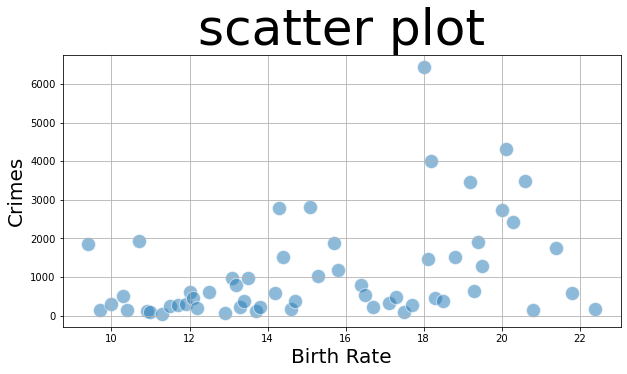

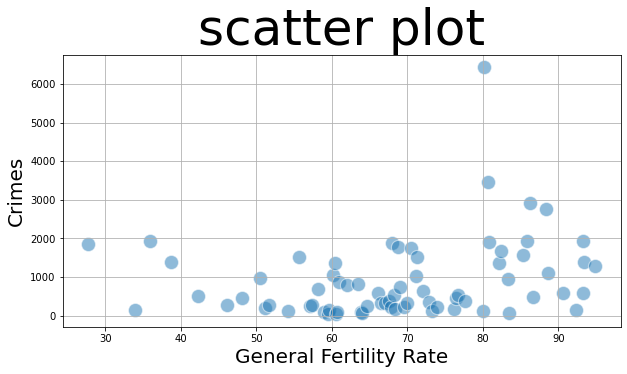

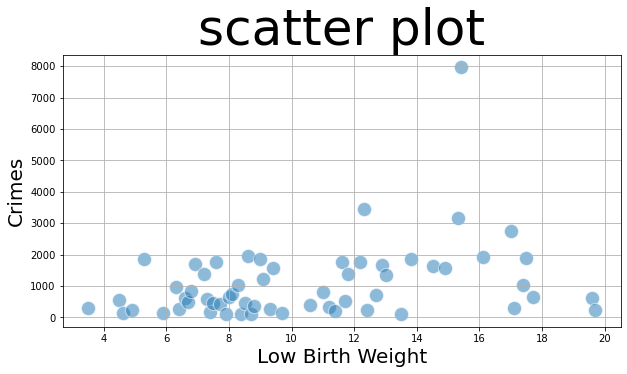

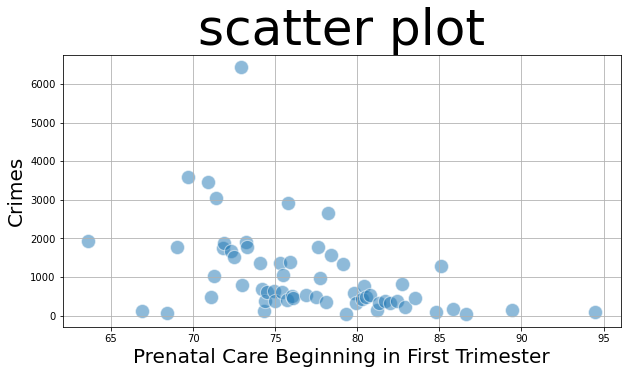

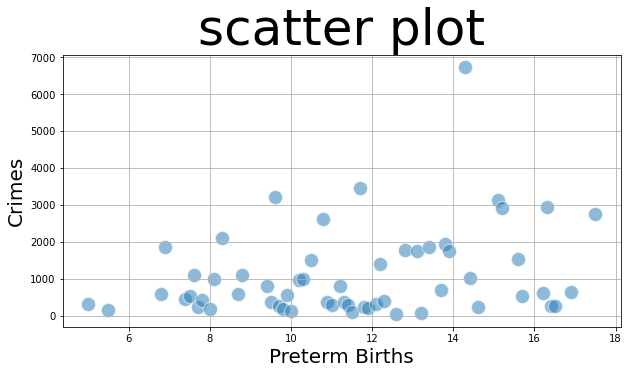

...

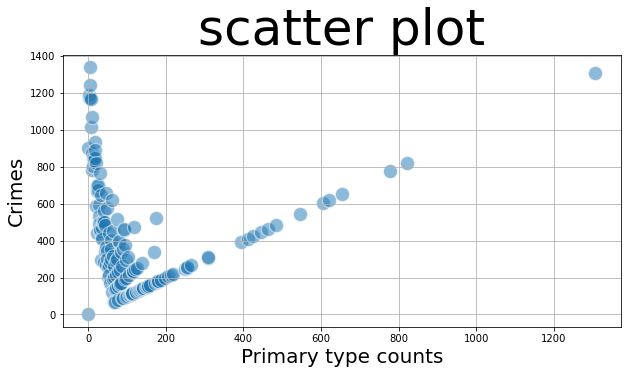

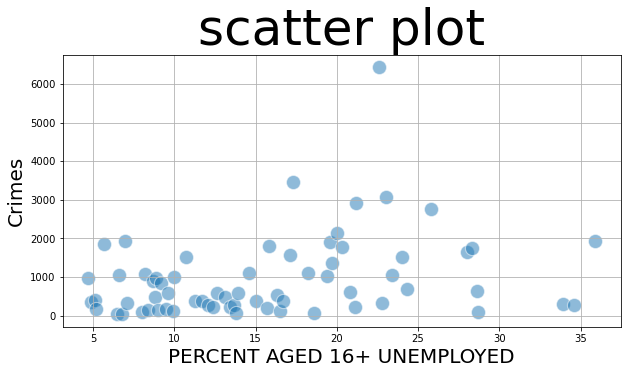

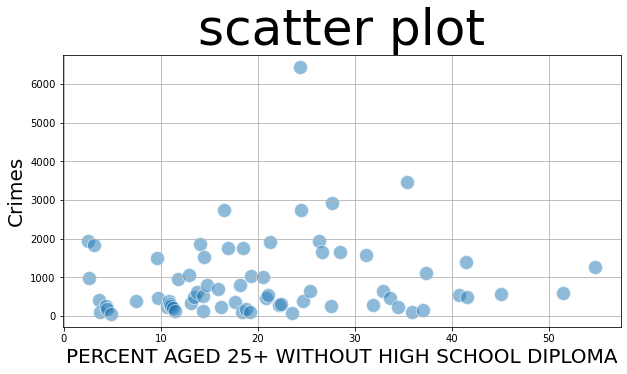

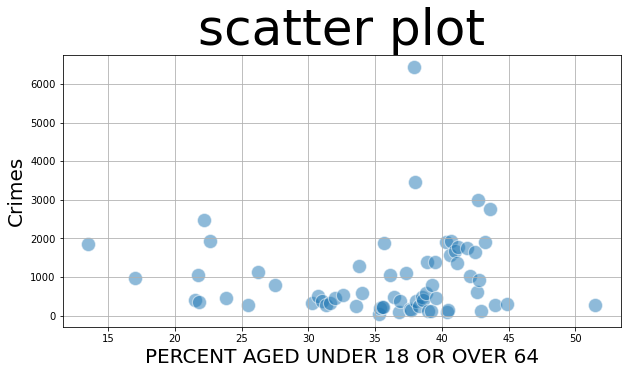

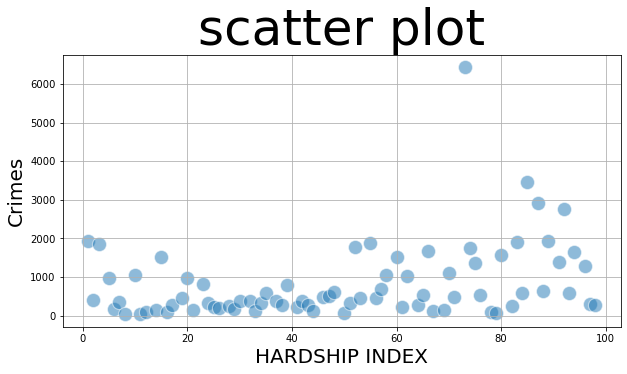

In [37]:
for x in df_num.columns:
    c=df.groupby([x]).agg({'Primary type counts':'sum'})
    c.rename({"Primary type counts":'sum'},axis=1,inplace=True)
    c = c.reset_index()
    plt.figure(figsize=(10,5))
    sns.scatterplot(x=x, y="sum",data=c,s=200,alpha=.5)
    plt.xlabel(x,fontsize=20)
    plt.ylabel('Crimes',fontsize=20)
    plt.title('scatter plot',fontsize=50)
#plt.xlim(20,20)
#plt.xticks(20)
#plt.xscale(20)
    plt.grid()
    #plt.savefig('D:\\nile\\Final project\\pic\\Sc\\'+x+'.png',dpi=300)
    plt.show()
    

In [42]:
#plotting scatter for MonthlyCharges and tenure
for v in df_cat.columns:
    c=df.groupby([v]).agg({'Primary type counts':'sum'})
    c.rename({"Primary type counts":'sum'},axis=1,inplace=True)
    c = c.reset_index()
    #c
    plt.figure(figsize=(500,200))
    sns.barplot(x=v,y="sum",data=c,order=c.sort_values('sum')[v])
    plt.xlabel(v,fontsize=300)
    plt.ylabel('Crimes',fontsize=300)
    plt.title('Barplot',fontsize=500)
    plt.xticks(fontsize=300,rotation ='vertical')
    plt.yticks(fontsize=300)
#plt.xlim(20,20)
#plt.xticks(600)
#plt.yscale(20)
    plt.grid()
    #plt.savefig('D:\\nile\\Final project\\pic\\bar\\'+v+'.png',dpi=300)
    plt.show()
    
    

# Data preparation

In [38]:
df.head(5)

,Birth Rate,General Fertility Rate,Low Birth Weight,Prenatal Care Beginning in First Trimester,Preterm Births,Teen Birth Rate,Assault (Homicide),Breast cancer in females,Cancer (All Sites),Colorectal Cancer,Diabetes-related,Firearm-related,Infant Mortality Rate,Lung Cancer,Prostate Cancer in Males,Stroke (Cerebrovascular Disease),Childhood Blood Lead Level Screening,Childhood Lead Poisoning,Gonorrhea in Females,Gonorrhea in Males,Tuberculosis,Below Poverty Level,Crowded Housing,Dependency,No High School Diploma,Per Capita Income,Unemployment,Day parts,Primary Type,Primary type counts,COMMUNITY AREA NAME,PERCENT AGED 16+ UNEMPLOYED,PERCENT AGED 25+ WITHOUT HIGH SCHOOL DIPLOMA,PERCENT AGED UNDER 18 OR OVER 64,HARDSHIP INDEX
0,16.4,62.0,11.0,73.0,11.2,40.8,7.7,23.3,176.9,25.3,77.1,5.2,6.4,36.7,21.7,33.7,364.7,0.5,322.5,423.3,11.4,22.7,7.9,28.8,18.1,23714,7.5,night,ARSON,0,Rogers Park,8.7,18.2,27.5,39.0
1,16.4,62.0,11.0,73.0,11.2,40.8,7.7,23.3,176.9,25.3,77.1,5.2,6.4,36.7,21.7,33.7,364.7,0.5,322.5,423.3,11.4,22.7,7.9,28.8,18.1,23714,7.5,night,ASSAULT,21,Rogers Park,8.7,18.2,27.5,39.0
2,16.4,62.0,11.0,73.0,11.2,40.8,7.7,23.3,176.9,25.3,77.1,5.2,6.4,36.7,21.7,33.7,364.7,0.5,322.5,423.3,11.4,22.7,7.9,28.8,18.1,23714,7.5,night,BATTERY,50,Rogers Park,8.7,18.2,27.5,39.0
3,16.4,62.0,11.0,73.0,11.2,40.8,7.7,23.3,176.9,25.3,77.1,5.2,6.4,36.7,21.7,33.7,364.7,0.5,322.5,423.3,11.4,22.7,7.9,28.8,18.1,23714,7.5,night,BURGLARY,7,Rogers Park,8.7,18.2,27.5,39.0
4,16.4,62.0,11.0,73.0,11.2,40.8,7.7,23.3,176.9,25.3,77.1,5.2,6.4,36.7,21.7,33.7,364.7,0.5,322.5,423.3,11.4,22.7,7.9,28.8,18.1,23714,7.5,night,CONCEALED CARRY LICENSE VIOLATION,0,Rogers Park,8.7,18.2,27.5,39.0


In [44]:
correlation_matrix =df_num.corr().round(2)
#annot = True to print the values inside the square
sns.set(rc={'figure.figsize':(200,150)})
sns.set(font_scale=12)
sns.heatmap(data=correlation_matrix,annot=True,annot_kws={"size":120})


<AxesSubplot:>

In [42]:
df_dummies=pd.get_dummies(df_cat)
df_dummies.head()

,Day parts_afternoon,Day parts_evening,Day parts_morning,Day parts_night,Primary Type_ARSON,Primary Type_ASSAULT,Primary Type_BATTERY,Primary Type_BURGLARY,Primary Type_CONCEALED CARRY LICENSE VIOLATION,Primary Type_CRIM SEXUAL ASSAULT,Primary Type_CRIMINAL DAMAGE,Primary Type_CRIMINAL TRESPASS,Primary Type_DECEPTIVE PRACTICE,Primary Type_GAMBLING,Primary Type_HOMICIDE,Primary Type_INTERFERENCE WITH PUBLIC OFFICER,Primary Type_INTIMIDATION,Primary Type_KIDNAPPING,Primary Type_LIQUOR LAW VIOLATION,Primary Type_MOTOR VEHICLE THEFT,Primary Type_NARCOTICS,Primary Type_OBSCENITY,Primary Type_OFFENSE INVOLVING CHILDREN,Primary Type_OTHER NARCOTIC VIOLATION,Primary Type_OTHER OFFENSE,Primary Type_PROSTITUTION,Primary Type_PUBLIC INDECENCY,Primary Type_PUBLIC PEACE VIOLATION,Primary Type_ROBBERY,Primary Type_SEX OFFENSE,Primary Type_STALKING,Primary Type_THEFT,Primary Type_WEAPONS VIOLATION,COMMUNITY AREA NAME_Albany Park,COMMUNITY AREA NAME_Archer Heights,COMMUNITY AREA NAME_Armour Square,COMMUNITY AREA NAME_Ashburn,COMMUNITY AREA NAME_Auburn Gresham,COMMUNITY AREA NAME_Austin,COMMUNITY AREA NAME_Avalon Park,COMMUNITY AREA NAME_Avondale,COMMUNITY AREA NAME_Belmont Cragin,COMMUNITY AREA NAME_Beverly,COMMUNITY AREA NAME_Bridgeport,COMMUNITY AREA NAME_Brighton Park,COMMUNITY AREA NAME_Burnside,COMMUNITY AREA NAME_Calumet Heights,COMMUNITY AREA NAME_Chatham,COMMUNITY AREA NAME_Chicago Lawn,COMMUNITY AREA NAME_Clearing,COMMUNITY AREA NAME_Douglas,COMMUNITY AREA NAME_Dunning,COMMUNITY AREA NAME_East Garfield Park,COMMUNITY AREA NAME_East Side,COMMUNITY AREA NAME_Edgewater,COMMUNITY AREA NAME_Edison Park,COMMUNITY AREA NAME_Englewood,COMMUNITY AREA NAME_Forest Glen,COMMUNITY AREA NAME_Fuller Park,COMMUNITY AREA NAME_Gage Park,COMMUNITY AREA NAME_Garfield Ridge,COMMUNITY AREA NAME_Grand Boulevard,COMMUNITY AREA NAME_Greater Grand Crossing,COMMUNITY AREA NAME_Hegewisch,COMMUNITY AREA NAME_Hermosa,COMMUNITY AREA NAME_Humboldt park,COMMUNITY AREA NAME_Hyde Park,COMMUNITY AREA NAME_Irving Park,COMMUNITY AREA NAME_Jefferson Park,COMMUNITY AREA NAME_Kenwood,COMMUNITY AREA NAME_Lake View,COMMUNITY AREA NAME_Lincoln Park,COMMUNITY AREA NAME_Lincoln Square,COMMUNITY AREA NAME_Logan Square,COMMUNITY AREA NAME_Loop,COMMUNITY AREA NAME_Lower West Side,COMMUNITY AREA NAME_McKinley Park,COMMUNITY AREA NAME_Montclaire,COMMUNITY AREA NAME_Morgan Park,COMMUNITY AREA NAME_Mount Greenwood,COMMUNITY AREA NAME_Near North Side,COMMUNITY AREA NAME_Near South Side,COMMUNITY AREA NAME_Near West Side,COMMUNITY AREA NAME_New City,COMMUNITY AREA NAME_North Center,COMMUNITY AREA NAME_North Lawndale,COMMUNITY AREA NAME_North Park,COMMUNITY AREA NAME_Norwood Park,COMMUNITY AREA NAME_O'Hare,COMMUNITY AREA NAME_Oakland,COMMUNITY AREA NAME_Portage Park,COMMUNITY AREA NAME_Pullman,COMMUNITY AREA NAME_Riverdale,COMMUNITY AREA NAME_Rogers Park,COMMUNITY AREA NAME_Roseland,COMMUNITY AREA NAME_South Chicago,COMMUNITY AREA NAME_South Deering,COMMUNITY AREA NAME_South Lawndale,COMMUNITY AREA NAME_South Shore,COMMUNITY AREA NAME_Uptown,COMMUNITY AREA NAME_Washington Height,COMMUNITY AREA NAME_Washington Park,COMMUNITY AREA NAME_West Elsdon,COMMUNITY AREA NAME_West Englewood,COMMUNITY AREA NAME_West Garfield Park,COMMUNITY AREA NAME_West Lawn,COMMUNITY AREA NAME_West Pullman,COMMUNITY AREA NAME_West Ridge,COMMUNITY AREA NAME_West Town,COMMUNITY AREA NAME_Woodlawn
0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

In [43]:
df_lb=df_cat.apply(LabelEncoder().fit_transform)
df_lb

,Day parts,Primary Type,COMMUNITY AREA NAME
0,3,0,60
1,3,1,60
2,3,2,60
3,3,3,60
4,3,4,60
...,...,...,...
8927,1,24,21
8928,1,25,21
8929,1,26,21
8930,1,27,21


In [44]:
features = df_num.columns.values
# define standard scaler
scaler = StandardScaler()
# transform data
scaled = pd.DataFrame(scaler.fit_transform(df_num))
scaled.columns=features
scaled.head()

,Birth Rate,General Fertility Rate,Low Birth Weight,Prenatal Care Beginning in First Trimester,Preterm Births,Teen Birth Rate,Assault (Homicide),Breast cancer in females,Cancer (All Sites),Colorectal Cancer,Diabetes-related,Firearm-related,Infant Mortality Rate,Lung Cancer,Prostate Cancer in Males,Stroke (Cerebrovascular Disease),Childhood Blood Lead Level Screening,Childhood Lead Poisoning,Gonorrhea in Females,Gonorrhea in Males,Tuberculosis,Below Poverty Level,Crowded Housing,Dependency,No High School Diploma,Per Capita Income,Unemployment,Primary type counts,PERCENT AGED 16+ UNEMPLOYED,PERCENT AGED 25+ WITHOUT HIGH SCHOOL DIPLOMA,PERCENT AGED UNDER 18 OR OVER 64,HARDSHIP INDEX
0,0.200043,-0.421875,0.231122,-0.758806,-0.021665,-0.331901,-0.630202,-0.27929,-0.383156,0.486002,0.241706,-0.802559,-0.496348,-0.905037,-0.738243,-0.894786,-0.174086,-0.476121,-0.700818,-0.590833,0.999512,0.210801,0.822073,-0.973337,-0.284826,-0.093754,-0.830771,-0.234072,-0.890377,-0.18232,-1.132799,-0.368602
1,0.200043,-0.421875,0.231122,-0.758806,-0.021665,-0.331901,-0.630202,-0.27929,-0.383156,0.486002,0.241706,-0.802559,-0.496348,-0.905037,-0.738243,-0.894786,-0.174086,-0.476121,-0.700818,-0.590833,0.999512,0.210801,0.822073,-0.973337,-0.284826,-0.093754,-0.830771,0.454025,-0.890377,-0.18232,-1.132799,-0.368602
2,0.200043,-0.421875,0.231122,-0.758806,-0.021665,-0.331901,-0.630202,-0.27929,-0.383156,0.486002,0.241706,-0.802559,-0.496348,-0.905037,-0.738243,-0.894786,-0.174086,-0.476121,-0.700818,-0.590833,0.999512,0.210801,0.822073,-0.973337,-0.284826,-0.093754,-0.830771,1.404255,-0.890377,-0.18232,-1.132799,-0.368602
3,0.200043,-0.421875,0.231122,-0.758806,-0.021665,-0.331901,-0.630202,-0.27929,-0.383156,0.486002,0.241706,-0.802559,-0.496348,-0.905037,-0.738243,-0.894786,-0.174086,-0.476121,-0.700818,-0.590833,0.999512,0.210801,0.822073,-0.973337,-0.284826,-0.093754,-0.830771,-0.004707,-0.890377,-0.18232,-1.132799,-0.368602
4,0.200043,-0.421875,0.231122,-0.758806,-0.021665,-0.331901,-0.630202,-0.27929,-0.383156,0.486002,0.241706,-0.802559,-0.496348,-0.905037,-0.738243,-0.894786,-0.174086,-0.476121,-0.700818,-0.590833,0.999512,0.210801,0.822073,-0.973337,-0.284826,-0.093754,-0.830771,-0.234072,-0.890377,-0.18232,-1.132799,-0.368602


In [45]:
df_lb=pd.concat([scaled,df_lb],axis=1)
df_lb

,Birth Rate,General Fertility Rate,Low Birth Weight,Prenatal Care Beginning in First Trimester,Preterm Births,Teen Birth Rate,Assault (Homicide),Breast cancer in females,Cancer (All Sites),Colorectal Cancer,Diabetes-related,Firearm-related,Infant Mortality Rate,Lung Cancer,Prostate Cancer in Males,Stroke (Cerebrovascular Disease),Childhood Blood Lead Level Screening,Childhood Lead Poisoning,Gonorrhea in Females,Gonorrhea in Males,Tuberculosis,Below Poverty Level,Crowded Housing,Dependency,No High School Diploma,Per Capita Income,Unemployment,Primary type counts,PERCENT AGED 16+ UNEMPLOYED,PERCENT AGED 25+ WITHOUT HIGH SCHOOL DIPLOMA,PERCENT AGED UNDER 18 OR OVER 64,HARDSHIP INDEX,Day parts,Primary Type,COMMUNITY AREA NAME
0,0.200043,-0.421875,0.231122,-0.758806,-0.021665,-0.331901,-0.630202,-0.279290,-0.383156,0.486002,0.241706,-0.802559,-0.496348,-0.905037,-0.738243,-0.894786,-0.174086,-0.476121,-0.700818,-0.590833,0.999512,0.210801,0.822073,-0.973337,-0.284826,-0.093754,-0.830771,-0.234072,-0.890377,-0.182320,-1.132799,-0.368602,3,0,60
1,0.200043,-0.421875,0.231122,-0.758806,-0.021665,-0.331901,-0.630202,-0.279290,-0.383156,0.486002,0.241706,-0.802559,-0.496348,-0.905037,-0.738243,-0.894786,-0.174086,-0.476121,-0.700818,-0.590833,0.999512,0.210801,0.822073,-0.973337,-0.284826,-0.093754,-0.830771,0.454025,-0.890377,-0.182320,-1.132799,-0.368602,3,1,60
2,0.200043,-0.421875,0.231122,-0.758806,-0.021665,-0.331901,-0.630202,-0.279290,-0.383156,0.486002,0.241706,-0.802559,-0.496348,-0.905037,-0.738243,-0.894786,-0.174086,-0.476121,-0.700818,-0.590833,0.999512,0.210801,0.822073,-0.973337,-0.284826,-0.093754,-0.830771,1.404255,-0.890377,-0.182320,-1.132799,-0.368602,3,2,60
3,0.200043,-0.421875,0.231122,-0.758806,-0.021665,-0.331901,-0.630202,-0.279290,-0.383156,0.486002,0.241706,-0.802559,-0.496348,-0.905037,-0.738243,-0.894786,-0.174086,-0.476121,-0.700818,-0.590833,0.999512,0.210801,0.822073,-0.973337,-0.284826,-0.093754,-0.830771,-0.004707,-0.890377,-0.182320,-1.132799,-0.368602,3,3,60
4,0.200043,-0.421875,0.231122,-0.758806,-0.021665,-0.331901,-0.630202,-0.279290,-0.383156,0.486002,0.241706,-0.802559,-0.496348,-0.905037,-0.738243,-0.894786,-0.174086,-0.476121,-0.700818,-0.590833,0.999512,0.210801,0.822073,-0.973337,-0.284826,-0.093754,-0.830771,-0.234072,-0.890377,-0.182320,-1.132799,-0.368602,3,4,60
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8927,-1.026515,-1.338878,-0.668985,-0.163972,-1.289489,-1.252561,-0.745681,-0.784802,-0.711678,-0.704287,-1.083328,-0.893038,-0.382194,-0.696868,-0.640496,-1.048049,-0.648295,0.048302,-0.948891,-0.584887,0.802060,-0.323252,-0.278790,-1.721007,-1.026200,0.555848,-0.616061,-0.168539,-0.823660,-0.905963,-1.641043,-1.070266,1,24,21
8928,-1.026515,-1.338878,-0.668985,-0.163972,-1.289489,-1.252561,-0.745681,-0.784802,-0.711678,-0.704287,-1.083328,-0.893038,-0.382194,-0.696868,-0.640496,-1.048049,-0.648295,0.048302,-0.948891,-0.584887,0.802060,-0.323252,-0.278790,-1.721007,-1.026200,0.555848,-0.616061,-0.103006,-0.823660,-0.905963,-1.641043,-1.070266,1,25,21
8929,-1.026515,-1.338878,-0.668985,-0.163972,-1.289489,-1.252561,-0.745681,-0.784802,-0.711678,-0.704287,-1.083328,-0.893038,-0.382194,-0.696868,-0.640496,-1.048049,-0.648295,0.048302,-0.948891,-0.584887,0.802060,-0.323252,-0.278790,-1.721007,-1.026200,0.555848,-0.616061,-0.234072,-0.823660,-0.905963,-1.641043,-1.070266,1,26,21
8930,-1.026515,-1.338878,-0.668985,-0.163972,-1.289489,-1.252561,-0.745681,-0.784802,-0.711678,-0.704287,-1.083328,-0.893038,-0.382194,-0.696868,-0.640496,-1.048049,-0.648295,0.048302,-0.948891,-0.584887,0.802060,-0.323252,-0.278790,-1.721007,-1.026200,0.555848,-0.616061,1.633621,-0.823660,-0.905963,-1.641043,-1.070266,1,27,21


In [46]:
df_OH=pd.concat([scaled,df_dummies],axis=1)
df_OH

,Birth Rate,General Fertility Rate,Low Birth Weight,Prenatal Care Beginning in First Trimester,Preterm Births,Teen Birth Rate,Assault (Homicide),Breast cancer in females,Cancer (All Sites),Colorectal Cancer,Diabetes-related,Firearm-related,Infant Mortality Rate,Lung Cancer,Prostate Cancer in Males,Stroke (Cerebrovascular Disease),Childhood Blood Lead Level Screening,Childhood Lead Poisoning,Gonorrhea in Females,Gonorrhea in Males,Tuberculosis,Below Poverty Level,Crowded Housing,Dependency,No High School Diploma,Per Capita Income,Unemployment,Primary type counts,PERCENT AGED 16+ UNEMPLOYED,PERCENT AGED 25+ WITHOUT HIGH SCHOOL DIPLOMA,PERCENT AGED UNDER 18 OR OVER 64,HARDSHIP INDEX,Day parts_afternoon,Day parts_evening,Day parts_morning,Day parts_night,Primary Type_ARSON,Primary Type_ASSAULT,Primary Type_BATTERY,Primary Type_BURGLARY,Primary Type_CONCEALED CARRY LICENSE VIOLATION,Primary Type_CRIM SEXUAL ASSAULT,Primary Type_CRIMINAL DAMAGE,Primary Type_CRIMINAL TRESPASS,Primary Type_DECEPTIVE PRACTICE,Primary Type_GAMBLING,Primary Type_HOMICIDE,Primary Type_INTERFERENCE WITH PUBLIC OFFICER,Primary Type_INTIMIDATION,Primary Type_KIDNAPPING,Primary Type_LIQUOR LAW VIOLATION,Primary Type_MOTOR VEHICLE THEFT,Primary Type_NARCOTICS,Primary Type_OBSCENITY,Primary Type_OFFENSE INVOLVING CHILDREN,Primary Type_OTHER NARCOTIC VIOLATION,Primary Type_OTHER OFFENSE,Primary Type_PROSTITUTION,Primary Type_PUBLIC INDECENCY,Primary Type_PUBLIC PEACE VIOLATION,Primary Type_ROBBERY,Primary Type_SEX OFFENSE,Primary Type_STALKING,Primary Type_THEFT,Primary Type_WEAPONS VIOLATION,COMMUNITY AREA NAME_Albany Park,COMMUNITY AREA NAME_Archer Heights,COMMUNITY AREA NAME_Armour Square,COMMUNITY AREA NAME_Ashburn,COMMUNITY AREA NAME_Auburn Gresham,COMMUNITY AREA NAME_Austin,COMMUNITY AREA NAME_Avalon Park,COMMUNITY AREA NAME_Avondale,COMMUNITY AREA NAME_Belmont Cragin,COMMUNITY AREA NAME_Beverly,COMMUNITY AREA NAME_Bridgeport,COMMUNITY AREA NAME_Brighton Park,COMMUNITY AREA NAME_Burnside,COMMUNITY AREA NAME_Calumet Heights,COMMUNITY AREA NAME_Chatham,COMMUNITY AREA NAME_Chicago Lawn,COMMUNITY AREA NAME_Clearing,COMMUNITY AREA NAME_Douglas,COMMUNITY AREA NAME_Dunning,COMMUNITY AREA NAME_East Garfield Park,COMMUNITY AREA NAME_East Side,COMMUNITY AREA NAME_Edgewater,COMMUNITY AREA NAME_Edison Park,COMMUNITY AREA NAME_Englewood,COMMUNITY AREA NAME_Forest Glen,COMMUNITY AREA NAME_Fuller Park,COMMUNITY AREA NAME_Gage Park,COMMUNITY AREA NAME_Garfield Ridge,COMMUNITY AREA NAME_Grand Boulevard,COMMUNITY AREA NAME_Greater Grand Crossing,COMMUNITY AREA NAME_Hegewisch,COMMUNITY AREA NAME_Hermosa,COMMUNITY AREA NAME_Humboldt park,COMMUNITY AREA NAME_Hyde Park,COMMUNITY AREA NAME_Irving Park,COMMUNITY AREA NAME_Jefferson Park,COMMUNITY AREA NAME_Kenwood,COMMUNITY AREA NAME_Lake View,COMMUNITY AREA NAME_Lincoln Park,COMMUNITY AREA NAME_Lincoln Square,COMMUNITY AREA NAME_Logan Square,COMMUNITY AREA NAME_Loop,COMMUNITY AREA NAME_Lower West Side,COMMUNITY AREA NAME_McKinley Park,COMMUNITY AREA NAME_Montclaire,COMMUNITY AREA NAME_Morgan Park,COMMUNITY AREA NAME_Mount Greenwood,COMMUNITY AREA NAME_Near North Side,COMMUNITY AREA NAME_Near South Side,COMMUNITY AREA NAME_Near West Side,COMMUNITY AREA NAME_New City,COMMUNITY AREA NAME_North Center,COMMUNITY AREA NAME_North Lawndale,COMMUNITY AREA NAME_North Park,COMMUNITY AREA NAME_Norwood Park,COMMUNITY AREA NAME_O'Hare,COMMUNITY AREA NAME_Oakland,COMMUNITY AREA NAME_Portage Park,COMMUNITY AREA NAME_Pullman,COMMUNITY AREA NAME_Riverdale,COMMUNITY AREA NAME_Rogers Park,COMMUNITY AREA NAME_Roseland,COMMUNITY AREA NAME_South Chicago,COMMUNITY AREA NAME_South Deering,COMMUNITY AREA NAME_South Lawndale,COMMUNITY AREA NAME_South Shore,COMMUNITY AREA NAME_Uptown,COMMUNITY AREA NAME_Washington Height,COMMUNITY AREA NAME_Washington Park,COMMUNITY AREA NAME_West Elsdon,COMMUNITY AREA NAME_West Englewood,COMMUNITY AREA NAME_West Garfield Park,COMMUNITY AREA NAME_West Lawn,COMMUNITY AREA NAME_West Pullman,COMMUNITY AREA NAME_West Ridge,COM

In [47]:
y=df['Primary type counts']
x_OH=df_OH.drop(['Primary type counts'],axis=1)
x_OH

,Birth Rate,General Fertility Rate,Low Birth Weight,Prenatal Care Beginning in First Trimester,Preterm Births,Teen Birth Rate,Assault (Homicide),Breast cancer in females,Cancer (All Sites),Colorectal Cancer,Diabetes-related,Firearm-related,Infant Mortality Rate,Lung Cancer,Prostate Cancer in Males,Stroke (Cerebrovascular Disease),Childhood Blood Lead Level Screening,Childhood Lead Poisoning,Gonorrhea in Females,Gonorrhea in Males,Tuberculosis,Below Poverty Level,Crowded Housing,Dependency,No High School Diploma,Per Capita Income,Unemployment,PERCENT AGED 16+ UNEMPLOYED,PERCENT AGED 25+ WITHOUT HIGH SCHOOL DIPLOMA,PERCENT AGED UNDER 18 OR OVER 64,HARDSHIP INDEX,Day parts_afternoon,Day parts_evening,Day parts_morning,Day parts_night,Primary Type_ARSON,Primary Type_ASSAULT,Primary Type_BATTERY,Primary Type_BURGLARY,Primary Type_CONCEALED CARRY LICENSE VIOLATION,Primary Type_CRIM SEXUAL ASSAULT,Primary Type_CRIMINAL DAMAGE,Primary Type_CRIMINAL TRESPASS,Primary Type_DECEPTIVE PRACTICE,Primary Type_GAMBLING,Primary Type_HOMICIDE,Primary Type_INTERFERENCE WITH PUBLIC OFFICER,Primary Type_INTIMIDATION,Primary Type_KIDNAPPING,Primary Type_LIQUOR LAW VIOLATION,Primary Type_MOTOR VEHICLE THEFT,Primary Type_NARCOTICS,Primary Type_OBSCENITY,Primary Type_OFFENSE INVOLVING CHILDREN,Primary Type_OTHER NARCOTIC VIOLATION,Primary Type_OTHER OFFENSE,Primary Type_PROSTITUTION,Primary Type_PUBLIC INDECENCY,Primary Type_PUBLIC PEACE VIOLATION,Primary Type_ROBBERY,Primary Type_SEX OFFENSE,Primary Type_STALKING,Primary Type_THEFT,Primary Type_WEAPONS VIOLATION,COMMUNITY AREA NAME_Albany Park,COMMUNITY AREA NAME_Archer Heights,COMMUNITY AREA NAME_Armour Square,COMMUNITY AREA NAME_Ashburn,COMMUNITY AREA NAME_Auburn Gresham,COMMUNITY AREA NAME_Austin,COMMUNITY AREA NAME_Avalon Park,COMMUNITY AREA NAME_Avondale,COMMUNITY AREA NAME_Belmont Cragin,COMMUNITY AREA NAME_Beverly,COMMUNITY AREA NAME_Bridgeport,COMMUNITY AREA NAME_Brighton Park,COMMUNITY AREA NAME_Burnside,COMMUNITY AREA NAME_Calumet Heights,COMMUNITY AREA NAME_Chatham,COMMUNITY AREA NAME_Chicago Lawn,COMMUNITY AREA NAME_Clearing,COMMUNITY AREA NAME_Douglas,COMMUNITY AREA NAME_Dunning,COMMUNITY AREA NAME_East Garfield Park,COMMUNITY AREA NAME_East Side,COMMUNITY AREA NAME_Edgewater,COMMUNITY AREA NAME_Edison Park,COMMUNITY AREA NAME_Englewood,COMMUNITY AREA NAME_Forest Glen,COMMUNITY AREA NAME_Fuller Park,COMMUNITY AREA NAME_Gage Park,COMMUNITY AREA NAME_Garfield Ridge,COMMUNITY AREA NAME_Grand Boulevard,COMMUNITY AREA NAME_Greater Grand Crossing,COMMUNITY AREA NAME_Hegewisch,COMMUNITY AREA NAME_Hermosa,COMMUNITY AREA NAME_Humboldt park,COMMUNITY AREA NAME_Hyde Park,COMMUNITY AREA NAME_Irving Park,COMMUNITY AREA NAME_Jefferson Park,COMMUNITY AREA NAME_Kenwood,COMMUNITY AREA NAME_Lake View,COMMUNITY AREA NAME_Lincoln Park,COMMUNITY AREA NAME_Lincoln Square,COMMUNITY AREA NAME_Logan Square,COMMUNITY AREA NAME_Loop,COMMUNITY AREA NAME_Lower West Side,COMMUNITY AREA NAME_McKinley Park,COMMUNITY AREA NAME_Montclaire,COMMUNITY AREA NAME_Morgan Park,COMMUNITY AREA NAME_Mount Greenwood,COMMUNITY AREA NAME_Near North Side,COMMUNITY AREA NAME_Near South Side,COMMUNITY AREA NAME_Near West Side,COMMUNITY AREA NAME_New City,COMMUNITY AREA NAME_North Center,COMMUNITY AREA NAME_North Lawndale,COMMUNITY AREA NAME_North Park,COMMUNITY AREA NAME_Norwood Park,COMMUNITY AREA NAME_O'Hare,COMMUNITY AREA NAME_Oakland,COMMUNITY AREA NAME_Portage Park,COMMUNITY AREA NAME_Pullman,COMMUNITY AREA NAME_Riverdale,COMMUNITY AREA NAME_Rogers Park,COMMUNITY AREA NAME_Roseland,COMMUNITY AREA NAME_South Chicago,COMMUNITY AREA NAME_South Deering,COMMUNITY AREA NAME_South Lawndale,COMMUNITY AREA NAME_South Shore,COMMUNITY AREA NAME_Uptown,COMMUNITY AREA NAME_Washington Height,COMMUNITY AREA NAME_Washington Park,COMMUNITY AREA NAME_West Elsdon,COMMUNITY AREA NAME_West Englewood,COMMUNITY AREA NAME_West Garfield Park,COMMUNITY AREA NAME_West Lawn,COMMUNITY AREA NAME_West Pullman,COMMUNITY AREA NAME_West Ridge,COMMUNITY AREA NAME_Wes

In [48]:
y=df['Primary type counts']
x_lb=df_lb.drop(['Primary type counts'],axis=1)
x_lb

,Birth Rate,General Fertility Rate,Low Birth Weight,Prenatal Care Beginning in First Trimester,Preterm Births,Teen Birth Rate,Assault (Homicide),Breast cancer in females,Cancer (All Sites),Colorectal Cancer,Diabetes-related,Firearm-related,Infant Mortality Rate,Lung Cancer,Prostate Cancer in Males,Stroke (Cerebrovascular Disease),Childhood Blood Lead Level Screening,Childhood Lead Poisoning,Gonorrhea in Females,Gonorrhea in Males,Tuberculosis,Below Poverty Level,Crowded Housing,Dependency,No High School Diploma,Per Capita Income,Unemployment,PERCENT AGED 16+ UNEMPLOYED,PERCENT AGED 25+ WITHOUT HIGH SCHOOL DIPLOMA,PERCENT AGED UNDER 18 OR OVER 64,HARDSHIP INDEX,Day parts,Primary Type,COMMUNITY AREA NAME
0,0.200043,-0.421875,0.231122,-0.758806,-0.021665,-0.331901,-0.630202,-0.279290,-0.383156,0.486002,0.241706,-0.802559,-0.496348,-0.905037,-0.738243,-0.894786,-0.174086,-0.476121,-0.700818,-0.590833,0.999512,0.210801,0.822073,-0.973337,-0.284826,-0.093754,-0.830771,-0.890377,-0.182320,-1.132799,-0.368602,3,0,60
1,0.200043,-0.421875,0.231122,-0.758806,-0.021665,-0.331901,-0.630202,-0.279290,-0.383156,0.486002,0.241706,-0.802559,-0.496348,-0.905037,-0.738243,-0.894786,-0.174086,-0.476121,-0.700818,-0.590833,0.999512,0.210801,0.822073,-0.973337,-0.284826,-0.093754,-0.830771,-0.890377,-0.182320,-1.132799,-0.368602,3,1,60
2,0.200043,-0.421875,0.231122,-0.758806,-0.021665,-0.331901,-0.630202,-0.279290,-0.383156,0.486002,0.241706,-0.802559,-0.496348,-0.905037,-0.738243,-0.894786,-0.174086,-0.476121,-0.700818,-0.590833,0.999512,0.210801,0.822073,-0.973337,-0.284826,-0.093754,-0.830771,-0.890377,-0.182320,-1.132799,-0.368602,3,2,60
3,0.200043,-0.421875,0.231122,-0.758806,-0.021665,-0.331901,-0.630202,-0.279290,-0.383156,0.486002,0.241706,-0.802559,-0.496348,-0.905037,-0.738243,-0.894786,-0.174086,-0.476121,-0.700818,-0.590833,0.999512,0.210801,0.822073,-0.973337,-0.284826,-0.093754,-0.830771,-0.890377,-0.182320,-1.132799,-0.368602,3,3,60
4,0.200043,-0.421875,0.231122,-0.758806,-0.021665,-0.331901,-0.630202,-0.279290,-0.383156,0.486002,0.241706,-0.802559,-0.496348,-0.905037,-0.738243,-0.894786,-0.174086,-0.476121,-0.700818,-0.590833,0.999512,0.210801,0.822073,-0.973337,-0.284826,-0.093754,-0.830771,-0.890377,-0.182320,-1.132799,-0.368602,3,4,60
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8927,-1.026515,-1.338878,-0.668985,-0.163972,-1.289489,-1.252561,-0.745681,-0.784802,-0.711678,-0.704287,-1.083328,-0.893038,-0.382194,-0.696868,-0.640496,-1.048049,-0.648295,0.048302,-0.948891,-0.584887,0.802060,-0.323252,-0.278790,-1.721007,-1.026200,0.555848,-0.616061,-0.823660,-0.905963,-1.641043,-1.070266,1,24,21
8928,-1.026515,-1.338878,-0.668985,-0.163972,-1.289489,-1.252561,-0.745681,-0.784802,-0.711678,-0.704287,-1.083328,-0.893038,-0.382194,-0.696868,-0.640496,-1.048049,-0.648295,0.048302,-0.948891,-0.584887,0.802060,-0.323252,-0.278790,-1.721007,-1.026200,0.555848,-0.616061,-0.823660,-0.905963,-1.641043,-1.070266,1,25,21
8929,-1.026515,-1.338878,-0.668985,-0.163972,-1.289489,-1.252561,-0.745681,-0.784802,-0.711678,-0.704287,-1.083328,-0.893038,-0.382194,-0.696868,-0.640496,-1.048049,-0.648295,0.048302,-0.948891,-0.584887,0.802060,-0.323252,-0.278790,-1.721007,-1.026200,0.555848,-0.616061,-0.823660,-0.905963,-1.641043,-1.070266,1,26,21
8930,-1.026515,-1.338878,-0.668985,-0.163972,-1.289489,-1.252561,-0.745681,-0.784802,-0.711678,-0.704287,-1.083328,-0.893038,-0.382194,-0.696868,-0.640496,-1.048049,-0.648295,0.048302,-0.948891,-0.584887,0.802060,-0.323252,-0.278790,-1.721007,-1.026200,0.555848,-0.616061,-0.823660,-0.905963,-1.641043,-1.070266,1,27,21


# Model Selection 

In [46]:
X_train_OH, X_test_OH, y_train_OH, y_test_OH = train_test_split(x_OH,y,test_size=0.20,random_state=2,shuffle = True)

In [47]:
X_train_lb, X_test_lb, y_train_lb, y_test_lb = train_test_split(x_lb,y,test_size=0.20,random_state=2,shuffle = True)

In [54]:
regressors = {
    "XGBRegressor": XGBRegressor(),
    "RandomForestRegressor": RandomForestRegressor(),
    "DecisionTreeRegressor": DecisionTreeRegressor(),
    "SVR": SVR(),
    "KernelRidge": KernelRidge(),
    "LinearRegression": LinearRegression(),
    'Lasso':Lasso(),
    'KernelReidge':KernelRidge(),
    "Ridge":Ridge(),
    "BayesianRidge": BayesianRidge(),
    "ElasticNet": ElasticNet(),
    'GradientBoostingRegresso': GradientBoostingRegressor()
}


In [55]:
df_models = pd.DataFrame(columns=['model','R2_test','R2_train','nrmse_test','nrmse_train'])

for key in regressors:

    print('*',key)

    regressor = regressors[key]
    #model = regressor.fit(X_train_lb,y_train_lb)
    #y_pred = model.predict(X_test)
    
    folds = KFold(n_splits =10,shuffle = True,random_state = 2)
    scores = cross_validate(regressor,X_train_lb,y_train_lb,scoring=('r2','neg_root_mean_squared_error'),
                            return_train_score=True,cv=folds)
                           
    row = {'model': key+'Label_encoder',
           'R2_test':scores['test_r2'].mean(),
           'R2_train':scores['train_r2'].mean(),
           'nrmse_test':scores['test_neg_root_mean_squared_error'].mean(),
           'nrmse_train':scores['train_neg_root_mean_squared_error'].mean()
          
    }
    
    df_models = df_models.append(row, ignore_index=True)
    
    scores = cross_validate(regressor,X_train_OH,y_train_OH,scoring=('r2','neg_root_mean_squared_error'),
                            return_train_score=True,cv=folds)
                           
    row = {'model': key+'One_hot',
           'R2_test':scores['test_r2'].mean(),
           'R2_train':scores['train_r2'].mean(),
           'nrmse_test':scores['test_neg_root_mean_squared_error'].mean(),
           'nrmse_train':scores['train_neg_root_mean_squared_error'].mean()
          
    }


    df_models = df_models.append(row, ignore_index=True)


* XGBRegressor
* RandomForestRegressor
* DecisionTreeRegressor
* SVR
* KernelRidge
* LinearRegression
* Lasso
* KernelReidge
* Ridge
* BayesianRidge
* ElasticNet
* GradientBoostingRegresso


In [56]:
df_models.head(20).sort_values(by='nrmse_test', ascending=False)

,model,R2_test,R2_train,nrmse_test,nrmse_train
0,XGBRegressorLabel_encoder,0.697495,0.988836,-14.030850,-2.928001
1,XGBRegressorOne_hot,0.693837,0.990964,-14.050821,-2.638447
2,RandomForestRegressorLabel_encoder,0.667189,0.944944,-14.854980,-6.548147
3,RandomForestRegressorOne_hot,0.509043,0.925624,-16.529543,-7.599405
4,DecisionTreeRegressorLabel_encoder,0.391619,1.000000,-17.717704,0.000000
19,BayesianRidgeOne_hot,0.278363,0.240397,-21.907758,-24.373945
5,DecisionTreeRegressorOne_hot,-0.321768,1.000000,-21.920929,0.000000
9,KernelRidgeOne_hot,0.270337,0.241415,-21.978686,-24.357555
15,KernelReidgeOne_hot,0.270337,0.241415,-21.978686,-24.357555
17,RidgeOne_hot,0.270329,0.241415,-21.978751,-24.357554


# Hyperparameter tuning

In [57]:
XGBRegressor().get_params

<bound method XGBModel.get_params of XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=None, gamma=None,
             gpu_id=None, importance_type='gain', interaction_constraints=None,
             learning_rate=None, max_delta_step=None, max_depth=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=None, num_parallel_tree=None,
             random_state=None, reg_alpha=None, reg_lambda=None,
             scale_pos_weight=None, subsample=None, tree_method=None,
             validate_parameters=None, verbosity=None)>

In [31]:
param_Random= dict(
    
    #base_score=[0.5,0.2,0.4,0.3],
    #booster=['gbtree','gblinea','dart'],
    #colsample_bylevel=[0.1,0.2,0.6,0.5],
    #colsample_bynode=[0.1,0.2,0.6,0.5],
    #colsample_bytree=[0.1,0.2,0.6,0.5],
    #n_jobs=[16,17,81],
    #learning_rate=[0.1, 0.5,0.7],
    #max_delta_step=[0,1,2,3],
    #objective=['reg:squarederror','reg:pseudohubererror','reg:squaredlogerror'],
    #max_depth=[5, 10, 15,100,500],
    #min_child_weight=[1,2,3,4],
    #n_estimators=[100, 500, 1000,2000],
    #subsample=[0.2,0.5,0.8, 1.0],
    #gamma=[0.2,0.5,0.7],
    #interaction_constraints=[[0, 1], [2, 3, 4]],
    #scale_pos_weight=[0,1,5,10],
    #reg_alpha=[0,0.5,0.7,0.6,0.9],
    #reg_lambda=[1,0,.1,3],
    #verbosity=[1,2,10,20],
    #random_state=[1,2,10,20]
    n_jobs=[16,17,18],
    learning_rate=[0.1,0.5],
    objective=['reg:squarederror'],
    max_depth=[5,10,15], 
    n_estimators=[100, 500, 1000],
    subsample=[0.2,0.8,1.0],
    gamma=[0.05,0.1],
    scale_pos_weight=[0,1],
    reg_alpha=[0,0.5,1],
    reg_lambda=[1,0,0.5],
   #booster=['gbtree','gblinear','dart']
)

model = XGBRegressor()

Random_search_XGB=RandomizedSearchCV(model,
                           param_Random,
                           scoring='neg_root_mean_squared_error',
                           cv=5)

Random_search_XGB.fit(X_train_lb,y_train_lb)

RandomizedSearchCV(cv=5,
                   estimator=XGBRegressor(base_score=None, booster=None,
                                          colsample_bylevel=None,
                                          colsample_bynode=None,
                                          colsample_bytree=None, gamma=None,
                                          gpu_id=None, importance_type='gain',
                                          interaction_constraints=None,
                                          learning_rate=None,
                                          max_delta_step=None, max_depth=None,
                                          min_child_weight=None, missing=nan,
                                          monotone_constraints=None,
                                          n_estimators=100, n...
                                          tree_method=None,
                                          validate_parameters=None,
                                          verbosity=None),
   

In [42]:
print("Tuned XGB Parameter: {}".format(Random_search_XGB.best_params_))
print("Tuned XGB best score:{}".format(Random_search_XGB.best_score_))
print('best estimator:{}'.format(Random_search_XGB.best_estimator_))

Tuned XGB Parameter: {'subsample': 1.0, 'scale_pos_weight': 1, 'reg_lambda': 0, 'reg_alpha': 0.5, 'objective': 'reg:squarederror', 'n_jobs': 17, 'n_estimators': 1000, 'max_depth': 5, 'learning_rate': 0.5, 'gamma': 0.05}
Tuned XGB best score:-15.926992941978998
best estimator:XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0.05, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.5, max_delta_step=0, max_depth=5,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=1000, n_jobs=17, num_parallel_tree=1, random_state=0,
             reg_alpha=0.5, reg_lambda=0, scale_pos_weight=1, subsample=1.0,
             tree_method='exact', validate_parameters=1, verbosity=None)


# Model building

In [115]:
regressor_tuned_random_search=XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0.05, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.1, max_delta_step=0, max_depth=5,
             min_child_weight=1, monotone_constraints='()',
             n_estimators=1000, n_jobs=17, num_parallel_tree=1, random_state=0,
             reg_alpha=0.5, reg_lambda=0, scale_pos_weight=1, subsample=1.0,
             tree_method='exact', validate_parameters=1, verbosity=None)
regressor_tuned_random_search.fit(X_train_lb, y_train_lb)
y_pred =abs(regressor_tuned_random_search.predict(X_test_lb)).astype(int)

np.sqrt(mean_squared_error(y_test_lb, y_pred))

16.373029811377396

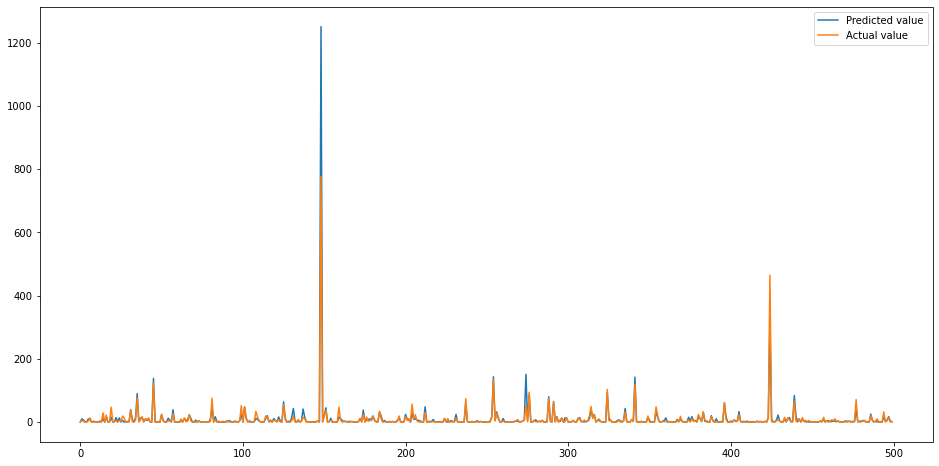

In [116]:
test = pd.DataFrame({'Predicted value':y_pred, 'Actual value':y_test_lb})
fig= plt.figure(figsize=(16,8))
test = test.reset_index()
test = test.drop(['index'],axis=1)
plt.plot(test[:500])
plt.legend(['Predicted value','Actual value'])
plt.savefig('D:\\nile\\Final project\\pic\\evalution\\validation.png',dpi=300)
plt.show()

# Features selection

In [45]:
# Create a pd.Series of features importances
importances_Random_Search_XGB= pd.Series(Random_search_XGB.best_estimator_.feature_importances_, index = x_lb.columns)
# Sort importances_dt
sorted_importances_Random_Search_XGB=importances_Random_Search_XGB.sort_values()
# Make a horizontal bar plot

plt.figure(figsize=(200,500))
sorted_importances_Random_Search_XGB.plot(kind='barh', color='lightgreen')   
#plt.xlabel(v,fontsize=300)
#plt.ylabel('Crimes',fontsize=300)
#plt.title('Barplot',fontsize=500)
#plt.xticks(fontsize=300,rotation ='vertical')
plt.yticks(fontsize=300)
plt.show()

# Fitting model using the most important features

In [108]:
sorted_importances_Random_Search_XGB

PERCENT AGED 25+ WITHOUT HIGH SCHOOL DIPLOMA    0.002484
PERCENT AGED 16+ UNEMPLOYED                     0.002497
Gonorrhea in Males                              0.002555
HARDSHIP INDEX                                  0.002923
Colorectal Cancer                               0.002942
Infant Mortality Rate                           0.005133
Childhood Blood Lead Level Screening            0.005217
Stroke (Cerebrovascular Disease)                0.005298
Unemployment                                    0.007516
Cancer (All Sites)                              0.008191
Lung Cancer                                     0.008293
No High School Diploma                          0.008959
Childhood Lead Poisoning                        0.009733
Assault (Homicide)                              0.010032
Firearm-related                                 0.012380
General Fertility Rate                          0.013847
Crowded Housing                                 0.015649
Low Birth Weight               

In [49]:
X_importance=x_lb[['Teen Birth Rate','PERCENT AGED UNDER 18 OR OVER 64','Diabetes-related','Primary Type',
                         'COMMUNITY AREA NAME','Preterm Births','Birth Rate','Dependency','Per Capita Income','Day parts']]

X_importance


,Teen Birth Rate,PERCENT AGED UNDER 18 OR OVER 64,Diabetes-related,Primary Type,COMMUNITY AREA NAME,Preterm Births,Birth Rate,Dependency,Per Capita Income,Day parts
0,-0.331901,-1.132799,0.241706,0,60,-0.021665,0.200043,-0.973337,-0.093754,3
1,-0.331901,-1.132799,0.241706,1,60,-0.021665,0.200043,-0.973337,-0.093754,3
2,-0.331901,-1.132799,0.241706,2,60,-0.021665,0.200043,-0.973337,-0.093754,3
3,-0.331901,-1.132799,0.241706,3,60,-0.021665,0.200043,-0.973337,-0.093754,3
4,-0.331901,-1.132799,0.241706,4,60,-0.021665,0.200043,-0.973337,-0.093754,3
...,...,...,...,...,...,...,...,...,...,...
8927,-1.252561,-1.641043,-1.083328,24,21,-1.289489,-1.026515,-1.721007,0.555848,1
8928,-1.252561,-1.641043,-1.083328,25,21,-1.289489,-1.026515,-1.721007,0.555848,1
8929,-1.252561,-1.641043,-1.083328,26,21,-1.289489,-1.026515,-1.721007,0.555848,1
8930,-1.252561,-1.641043,-1.083328,27,21,-1.289489,-1.026515,-1.721007,0.555848,1


In [50]:
X_train_importance, X_test_importance, y_train_importance, y_test_importance = train_test_split(X_importance,y,test_size=0.20,random_state=2,shuffle = True)
X_train_importance

,Teen Birth Rate,PERCENT AGED UNDER 18 OR OVER 64,Diabetes-related,Primary Type,COMMUNITY AREA NAME,Preterm Births,Birth Rate,Dependency,Per Capita Income,Day parts
3914,-1.213155,0.350722,-1.378300,28,2,0.178518,-1.197663,0.286625,-0.549619,0
8393,0.535024,0.941383,0.354076,12,67,1.646525,-1.055040,0.909683,-0.363355,2
3414,0.982815,-0.267412,-0.324828,21,64,-0.555485,1.084305,-0.377971,-0.970009,2
2299,0.703393,0.089732,-0.390378,8,31,-0.822396,1.312502,0.065093,-0.652681,1
1672,-0.299660,-0.239939,-1.111421,19,57,-0.855760,-0.427498,-0.170285,-0.100284,2
...,...,...,...,...,...,...,...,...,...,...
1099,-1.671694,0.515557,-1.153560,26,54,-0.989215,-1.511433,0.660460,0.441073,2
2514,0.574429,-1.311371,0.176156,20,40,-0.622213,0.713485,-1.264098,0.263830,0
6637,0.287843,0.488085,-0.104770,25,11,-0.989215,1.398076,0.549694,-0.805690,3
2575,0.997145,0.309513,1.037662,23,32,0.145154,0.998731,0.342008,-0.788659,3


In [51]:
Importance_XGB=XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0.05, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.1, max_delta_step=0, max_depth=5,
             min_child_weight=1, monotone_constraints='()',
             n_estimators=1000, n_jobs=17, num_parallel_tree=1, random_state=0,
             reg_alpha=0.5, reg_lambda=0, scale_pos_weight=1, subsample=1.0,
             tree_method='exact', validate_parameters=1, verbosity=None)
Importance_XGB.fit(X_train_importance, y_train_importance)
y_pred=abs(Importance_XGB.predict(X_test_importance)).astype(int)


In [52]:
np.sqrt(mean_squared_error(y_test_importance, y_pred))

17.975874524296792

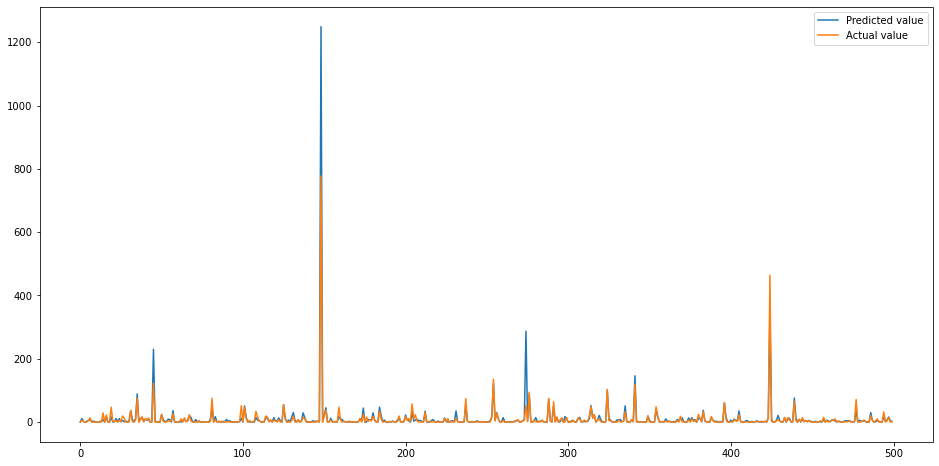

In [54]:
test = pd.DataFrame({'Predicted value':y_pred, 'Actual value':y_test_importance})
fig= plt.figure(figsize=(16,8))
test = test.reset_index()
test = test.drop(['index'],axis=1)
plt.plot(test[:500])
plt.legend(['Predicted value','Actual value'])
plt.show()

# Save Model

In [65]:
import pickle
pickle.dump(Importance_XGB, open("pima.pickle.dat", "wb"))
loaded_model = pickle.load(open("pima.pickle.dat", "rb"))
y_pred =abs(loaded_model.predict(X_test_importance)).astype(int)
np.sqrt(mean_squared_error(y_test_importance, y_pred))

17.975874524296792